# Correlation visualizations

Exploration on correlations and possibly other interesting connectivity measures obtained from the raw timeseries (as opposed to `correlations-notime` notebook that loads the fc matrices only data).

In [5]:
import pandas as pd
import numpy as np
import matplotlib as mlp
import matplotlib.pyplot as plt
import seaborn as sns

In [6]:
import os
import pickle

In [7]:
DATA_FOLDER = '../data'
PICKLE_FOLDER = '../pickles'

In [8]:
with open(f'{PICKLE_FOLDER}/fc-pearson.pickle', 'rb') as f:
    fc_pearson = pickle.load(f)

with open(f'{PICKLE_FOLDER}/fc-spearman.pickle', 'rb') as f:
    fc_spearman = pickle.load(f)

with open(f'{PICKLE_FOLDER}/fc-partial-pearson.pickle', 'rb') as f:
    fc_partial_pearson = pickle.load(f)

In [9]:
df = pd.read_csv(f'{DATA_FOLDER}/patients-cleaned.csv', index_col=0)

In [10]:
df.head()

,age,sex,target
0,24.750,1,0
1,27.667,1,0
2,34.167,1,0
3,28.917,1,0
4,31.917,0,0


In [11]:
target_index_change = 90    # Observe `df`.
subjects, brain_regions, _ = fc_pearson.shape

print('Samples: ', subjects)
print('Features: ', brain_regions)
print('Index where target feature changes: ', target_index_change)

Samples:  190
Features:  90
Index where target feature changes:  90


## Heatmaps

In [12]:
def plot_correlations(subject, fc=fc_pearson):
    """
    Displays heatmap of `subject's`th fc matrix.
    """
    sns.heatmap(fc[subject], cmap="YlGnBu")
    plt.title(f"Subject [{subject}] - {'control' if subject < target_index_change else 'patient'}")
    plt.show()

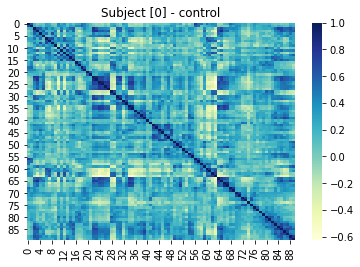

In [13]:
plot_correlations(0)

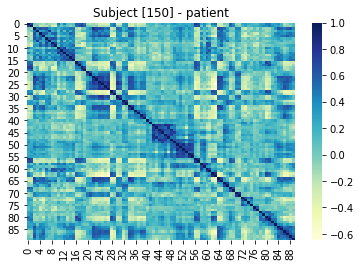

In [14]:
plot_correlations(150)

### Average heatmaps per group

In [15]:
fc = fc_spearman.copy()

In [16]:
avg_fc_control = np.mean(fc[0:target_index_change], axis=0)
avg_fc_patient = np.mean(fc[target_index_change:len(df)], axis=0)
avg_fc_diff = avg_fc_control - avg_fc_patient

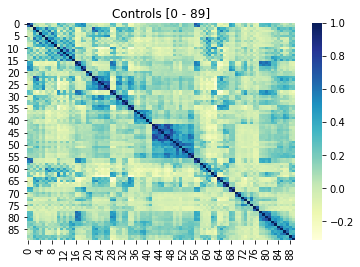

In [17]:
sns.heatmap(avg_fc_control, cmap="YlGnBu")
plt.title(f"Controls [0 - {target_index_change-1}]")
plt.show()

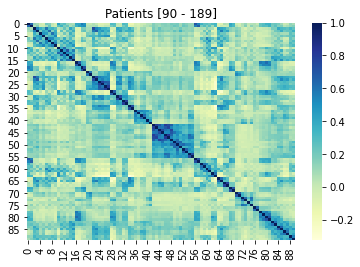

In [18]:
sns.heatmap(avg_fc_patient, cmap="YlGnBu")
plt.title(f"Patients [{target_index_change} - {df.shape[0] - 1}]")
plt.show()

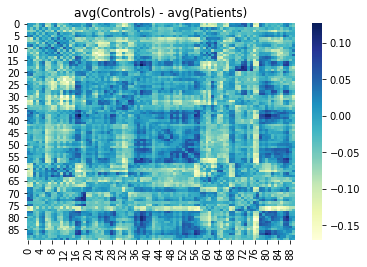

In [19]:
sns.heatmap(avg_fc_diff, cmap="YlGnBu")
plt.title("avg(Controls) - avg(Patients)")
plt.show()

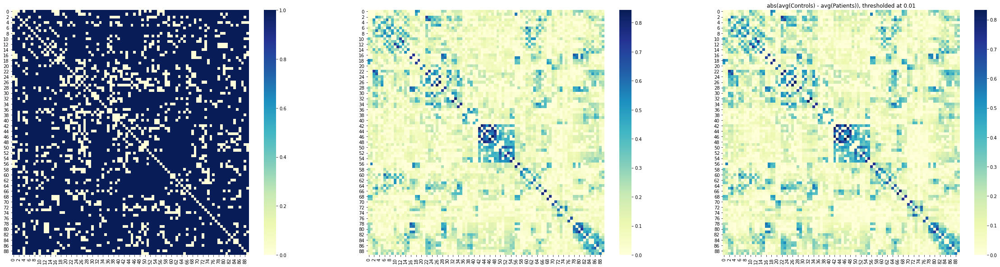

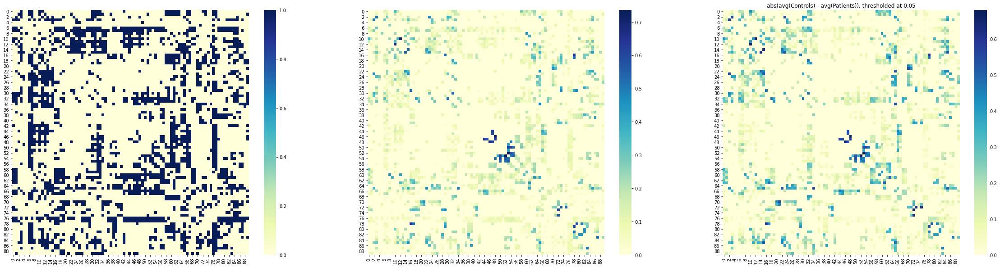

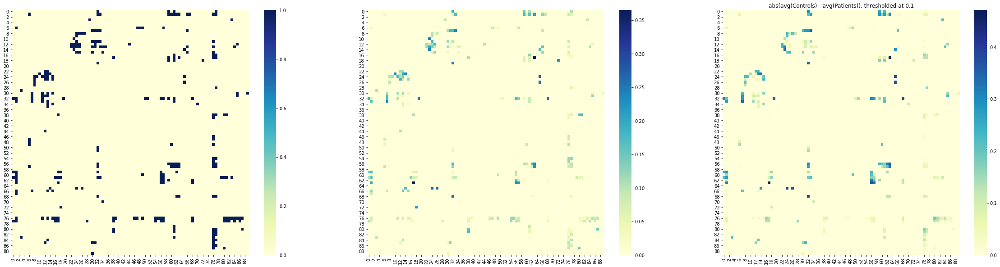

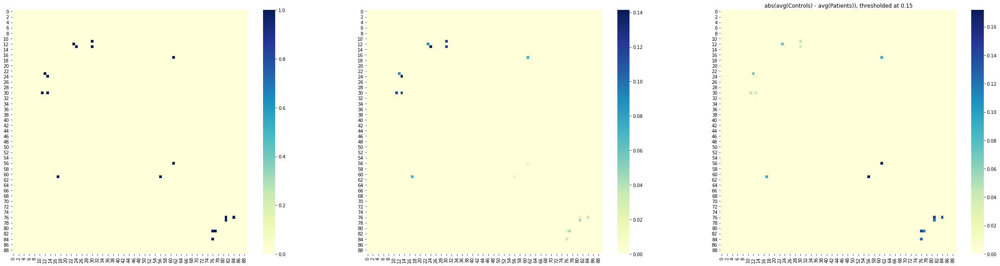

In [20]:
for min_diff_threshold in [0.01, 0.05, 0.1, 0.15]:
    fc_diff_thresholded = np.where(np.abs(avg_fc_diff) > min_diff_threshold, True, False)

    _, ax = plt.subplots(nrows=1, ncols=3, figsize=(40, 10))
    sns.heatmap(fc_diff_thresholded, cmap="YlGnBu", ax=ax[0])
    sns.heatmap(np.where(fc_diff_thresholded, np.abs(avg_fc_control), 0), cmap="YlGnBu",ax=ax[1])
    sns.heatmap(np.where(fc_diff_thresholded, np.abs(avg_fc_patient), 0), cmap="YlGnBu", ax=ax[2])

    plt.title(f"abs(avg(Controls) - avg(Patients)), thresholded at {min_diff_threshold}")
    plt.show()

## Histograms

In [21]:
def plot_histogram(subject, fc=fc_pearson, bins=brain_regions):
    """
    Displays histogram of `subject's`th fc matrix.
    """
    data = fc[subject].reshape(-1)
    plt.hist(data, bins=bins, alpha=0.5)
    plt.axvline(np.mean(data), c='k')
    plt.axvline(np.mean(data) + np.std(data), c='r')
    plt.axvline(np.mean(data) - np.std(data), c='r')
    plt.title(f"Subject [{subject}] - {'control' if subject < target_index_change else 'patient'}")

    plt.xlim([-1, 1])   # Fix for easier eye inspection.
    plt.show()

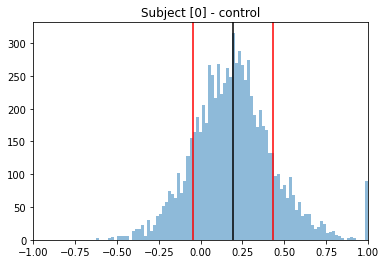

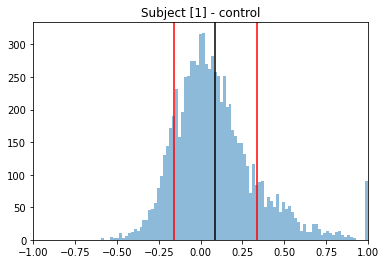

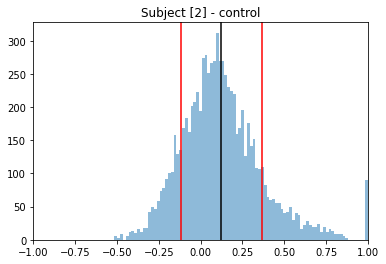

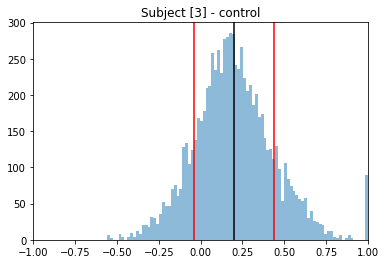

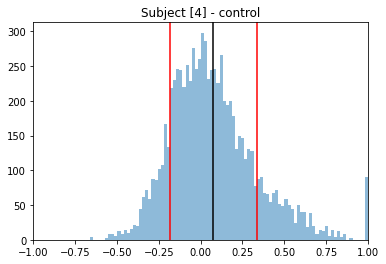

In [22]:
for i in range(5):
    plot_histogram(i)

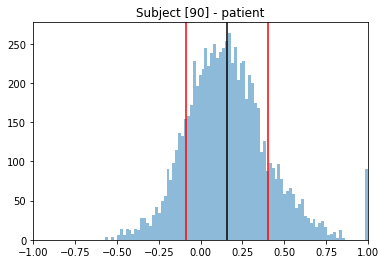

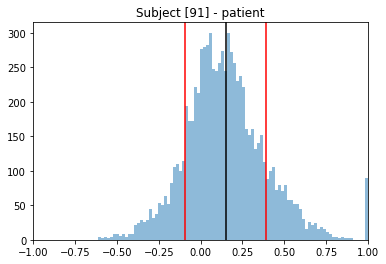

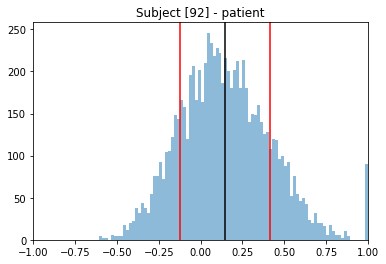

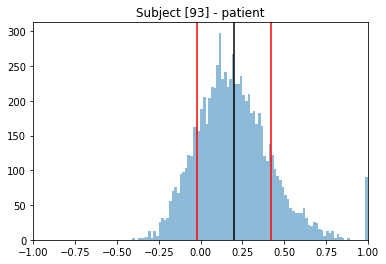

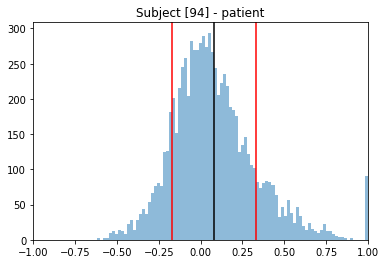

In [23]:
for i in range(target_index_change, target_index_change+5):
    plot_histogram(i)

### Average histograms per group

In [24]:
fc = fc_pearson.copy()

In [25]:
avg_fc_control = np.mean(fc[0:target_index_change], axis=0).reshape(-1)
avg_fc_patient = np.mean(fc[target_index_change:len(df)], axis=0).reshape(-1)

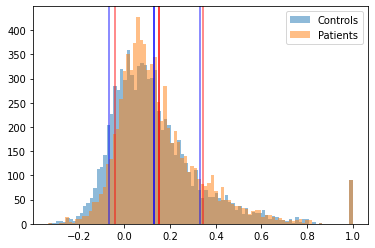

In [26]:
bins = brain_regions

plt.hist(avg_fc_control, bins=bins, label='Controls', alpha=0.5)
plt.hist(avg_fc_patient, bins=bins, label='Patients', alpha=0.5)

plt.axvline(np.mean(avg_fc_control), c='b')
plt.axvline(np.mean(avg_fc_control) + np.std(avg_fc_control), c='b', alpha=0.6)
plt.axvline(np.mean(avg_fc_control) - np.std(avg_fc_control), c='b', alpha=0.6)

plt.axvline(np.mean(avg_fc_patient), c='r')
plt.axvline(np.mean(avg_fc_patient) + np.std(avg_fc_patient), c='r', alpha=0.6)
plt.axvline(np.mean(avg_fc_patient) - np.std(avg_fc_patient), c='r', alpha=0.6)

plt.legend()
plt.show()

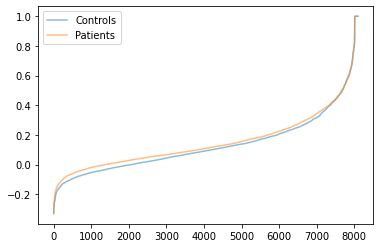

In [27]:
plt.plot(range(brain_regions*brain_regions), sorted(avg_fc_control), label='Controls', alpha=0.5)
plt.plot(range(brain_regions*brain_regions), sorted(avg_fc_patient), label='Patients', alpha=0.5)
plt.legend()
plt.show()

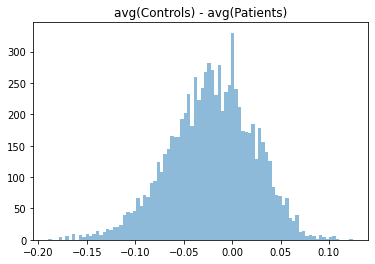

In [28]:
avg_difference = np.mean(fc[0:target_index_change], axis=0) - np.mean(fc[target_index_change:len(df)], axis=0)
bins = brain_regions

plt.hist(avg_difference.reshape(-1), bins=bins, alpha=0.5)
plt.title("avg(Controls) - avg(Patients)")
plt.show()

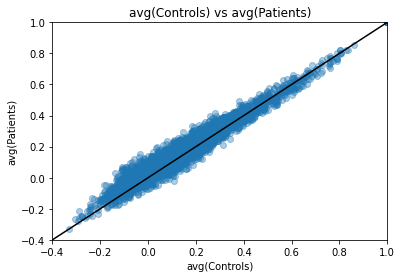

In [29]:
plt.scatter(avg_fc_control, avg_fc_patient, alpha=0.2)

axis_limit = [-0.4, 1]
plt.plot(axis_limit, axis_limit, c='k')
plt.ylim(axis_limit)
plt.xlim(axis_limit)

plt.xlabel("avg(Controls)")
plt.ylabel("avg(Patients)")
plt.title("avg(Controls) vs avg(Patients)")
plt.show()